In [1]:
! pip install -U albumentations

     |████████████████████████████████| 102 kB 6.4 MB/s 
     |████████████████████████████████| 47.6 MB 2.1 MB/s 
  Attempting uninstall: albumentations
    Found existing installation: albumentations 0.1.12
    Uninstalling albumentations-0.1.12:
      Successfully uninstalled albumentations-0.1.12


In [2]:
import matplotlib.pyplot as plt
import tensorflow as tf
from PIL import Image
import albumentations as A
import os
import glob
import numpy as np

## load data

In [3]:
dataset_path = '/content/drive/MyDrive/Colab-Notebooks/data/animal/'
train_path = os.path.join(dataset_path, 'train/')
test_path = os.path.join(dataset_path, 'test/')

print(train_path)
print(test_path)

/content/drive/MyDrive/Colab-Notebooks/data/animal/train/
/content/drive/MyDrive/Colab-Notebooks/data/animal/test/


In [4]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

In [ ]:
img_datagen = ImageDataGenerator(rescale=1/255)
img_datagen

In [ ]:
# Hyperparameter settings
img_w = 256
img_h = 256

learning_rate = 0.001
batch_size = 2
num_epochs = 20
n_classes = 1

In [ ]:
train_gen = img_datagen.flow_from_directory(
    directory = train_path,
    batch_size = batch_size,
    target_size = (img_w, img_h),
    class_mode = 'binary',
    color_mode="rgb",
    seed = 2,
    shuffle = True
)

train_gen.classes

Found 12 images belonging to 2 classes.


array([0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1], dtype=int32)

In [ ]:
train_data, label = next(train_gen)

print(train_data.shape)
print(label)

(2, 256, 256, 3)
[1. 0.]


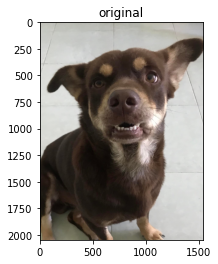

In [ ]:
ori_img = Image.open(train_path + 'dog/dog-4.jpg')
plt.title("original")
plt.imshow(ori_img)
plt.show()

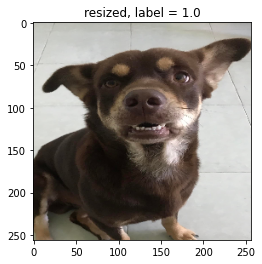

In [ ]:
plt.title("resized, label = {}".format(label[0]))
plt.imshow(train_data[0])
plt.show()

# [Problem 1] Learning classification with self-made dataset

### build net

In [ ]:
img_net = tf.keras.models.Sequential([
    #cnn
    tf.keras.layers.Conv2D(filters=8, kernel_size=(8, 8), kernel_initializer='he_uniform', bias_initializer='random_normal', activation='relu', input_shape=(img_w, img_h, 3)),
    tf.keras.layers.MaxPool2D(pool_size=(4,4), strides=(4,4)),    
    tf.keras.layers.Conv2D(filters=16, kernel_size=(8, 8), kernel_initializer='he_uniform', bias_initializer='random_normal', activation='relu'),
    tf.keras.layers.MaxPool2D(pool_size=(4,4), strides=(4,4)),
    #nn
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(120, kernel_initializer='he_uniform', bias_initializer='random_normal', activation='relu'),
    tf.keras.layers.Dense(84, kernel_initializer='he_uniform', bias_initializer='random_normal', activation='relu'),
    tf.keras.layers.Dense(n_classes),
    tf.keras.layers.Activation(tf.nn.sigmoid) #for binary classification
])

img_net.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_6 (Conv2D)           (None, 249, 249, 8)       1544      
                                                                 
 max_pooling2d_6 (MaxPooling  (None, 62, 62, 8)        0         
 2D)                                                             
                                                                 
 conv2d_7 (Conv2D)           (None, 55, 55, 16)        8208      
                                                                 
 max_pooling2d_7 (MaxPooling  (None, 13, 13, 16)       0         
 2D)                                                             
                                                                 
 flatten_3 (Flatten)         (None, 2704)              0         
                                                                 
 dense_9 (Dense)             (None, 120)              

In [ ]:
img_net.compile(
    loss='binary_crossentropy',
    optimizer=tf.keras.optimizers.Adam(learning_rate=learning_rate),
    metrics=['accuracy']
)

### train

In [ ]:
history = img_net.fit_generator(
    generator=train_gen,
    epochs=num_epochs
)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  This is separate from the ipykernel package so we can avoid doing imports until


Epoch 1/20
6/6 [==============================] - 2s 212ms/step - loss: 0.7729 - accuracy: 0.3333
Epoch 2/20
6/6 [==============================] - 1s 223ms/step - loss: 0.5677 - accuracy: 1.0000
Epoch 3/20
6/6 [==============================] - 1s 219ms/step - loss: 0.3325 - accuracy: 1.0000
Epoch 4/20
6/6 [==============================] - 1s 219ms/step - loss: 0.1742 - accuracy: 1.0000
Epoch 5/20
6/6 [==============================] - 1s 205ms/step - loss: 0.0766 - accuracy: 1.0000
Epoch 6/20
6/6 [==============================] - 1s 199ms/step - loss: 0.0592 - accuracy: 1.0000
Epoch 7/20
6/6 [==============================] - 1s 206ms/step - loss: 0.0374 - accuracy: 1.0000
Epoch 8/20
6/6 [==============================] - 1s 215ms/step - loss: 0.0211 - accuracy: 1.0000
Epoch 9/20
6/6 [==============================] - 1s 225ms/step - loss: 0.0128 - accuracy: 1.0000
Epoch 10/20
6/6 [==============================] - 1s 195ms/step - loss: 0.0014 - accuracy: 1.0000
Epoch 11/20
6/6 [==

### test

In [ ]:
def plot_history(title=None, loss=None, val_loss=None, loss_unit=None, metric=None, val_metric=None, metric_unit=None):
    fig, axes = plt.subplots(1, 2, figsize=(12, 5), sharey=True)
    fig.suptitle(title)

    if (loss is not None):
        axes[0].plot(loss, label='train')
    if (val_loss is not None):
        axes[0].plot(val_loss, label='val')
    axes[0].set_xlabel('epoch')
    axes[0].set_ylabel(loss_unit)
    axes[0].legend()

    if (metric is not None):
        axes[1].plot(metric, label='train')
    if (val_metric is not None):
        axes[1].plot(val_metric, label='val')
    axes[1].set_xlabel('epoch')
    axes[1].set_ylabel(metric_unit)
    axes[1].legend()

    #fig.tight_layout()

dict_keys(['loss', 'accuracy'])


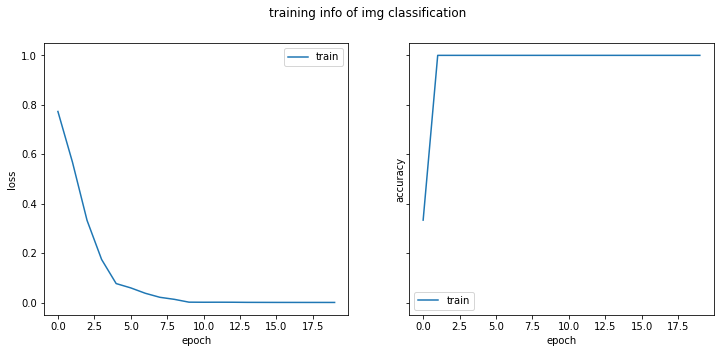

In [ ]:
print(history.history.keys())
plot_history(
    title="training info of img classification", 
    loss=history.history['loss'], 
    loss_unit="loss", 
    metric=history.history['accuracy'], 
    metric_unit="accuracy"
    )

In [ ]:
test_gen = img_datagen.flow_from_directory(
    directory = test_path,
    batch_size = 1,
    target_size = (img_w, img_h),
    class_mode = 'binary',
    color_mode="rgb",
    seed = 2,
    shuffle = False,
)

test_gen.classes

Found 4 images belonging to 2 classes.


array([0, 0, 1, 1], dtype=int32)

In [ ]:
img_net.evaluate_generator(test_gen, verbose=1, workers=1)

1/4 [======>.......................] - ETA: 0s - loss: 2.5313 - accuracy: 0.0000e+00

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: UserWarning: `Model.evaluate_generator` is deprecated and will be removed in a future version. Please use `Model.evaluate`, which supports generators.
  """Entry point for launching an IPython kernel.


4/4 [==============================] - 0s 39ms/step - loss: 0.6653 - accuracy: 0.7500


[0.6652959585189819, 0.75]

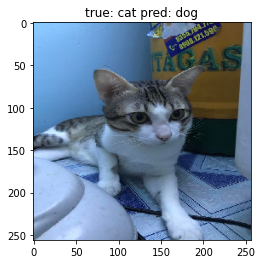

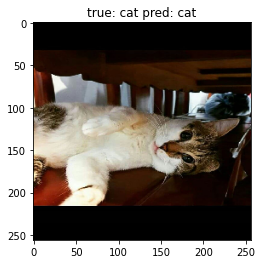

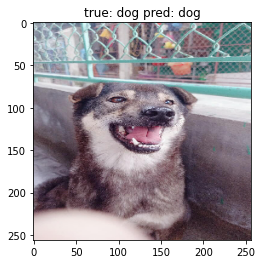

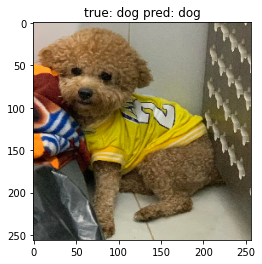

In [ ]:
for _ in range(test_gen.samples):
    img, label = test_gen.next()
    result = img_net.predict(img)
    plt.title("true: {} pred: {}".format("dog" if label == 1 else "cat", "dog" if result >= 0.5 else "cat"))
    plt.imshow(img[0])
    plt.show()

=> 3 out of 4 testcases passed.

# [Problem 2] Data expansion for classification dataset

In [ ]:
def augmentate_img_from_directory(src_path, des_path, repeat_times, compose_pipeline):
    """
    Augmentate images from the source folder for a repeat_times and store to a destination folder.
    Parameters:
    ----------
    src_path : path to get original images folder
    des_path : path to store augmentated images folder
    repeat_times : a repeated augmentation times for an image
    compose_pipeline : Compose pipeline from albumetation library
    """
    os.mkdir(des_path)
    img_file_list = [fi for fi in os.listdir(src_path) if (fi.endswith(".jpg"))]

    for i in range(len(img_name_list)):
        img_path = os.path.join(src_path, img_file_list[i])
        img = Image.open(img_path)
        img_np = np.array(img)
        for j in range(repeat_times):
            transformed_img = compose_pipeline(image=img_np)['image']
            transformed_file_name = "augmentated-" + str(j) + '-' + img_name_list[i]
            Image.fromarray(transformed_img).save(os.path.join(des_path, transformed_file_name))
            print("save image '{}' to '{}".format(transformed_file_name, des_path))
        img.close()

In [ ]:
def display_img_from_directory(src_path):
    img_file_list = [fi for fi in os.listdir(src_path) if (fi.endswith(".jpg"))]

    for i in range(len(img_file_list)):
        img_path = os.path.join(src_path, img_file_list[i])
        img = Image.open(img_path)
        plt.title(img_file_list[i])
        plt.imshow(img)
        plt.show()
        img.close()

In [ ]:
compose_pipeline_1 = A.Compose([
    A.Blur(always_apply=False, p=0.2, blur_limit=(3, 7)),
    A.ChannelShuffle(always_apply=False, p=0.5),
    A.HueSaturationValue(always_apply=False, p=1.0, hue_shift_limit=(-50, 50), sat_shift_limit=(-30, 30), val_shift_limit=(-20, 20)),
    A.Downscale(always_apply=False, p=0.2, scale_min=0.25, scale_max=0.75, interpolation=0),
    A.HorizontalFlip(always_apply=False, p=0.5),
    A.VerticalFlip(always_apply=False, p=0.5),
    A.Flip(always_apply=False, p=0.5),
    A.RandomRotate90(always_apply=False, p=0.5),
    A.RandomBrightnessContrast(always_apply=False, p=0.2)
])

### dog augmentation

In [ ]:
augmentate_img_from_directory(
    src_path=os.path.join(train_path, "dog"),
    des_path=os.path.join(train_path, "dog", "augmentated"),
    repeat_times=4,
    compose_pipeline=compose_pipeline_1
)

save image 'augmentated-0-dog-1.jpg' to '/content/drive/MyDrive/Colab-Notebooks/data/animal/train/dog/augmentated
save image 'augmentated-1-dog-1.jpg' to '/content/drive/MyDrive/Colab-Notebooks/data/animal/train/dog/augmentated
save image 'augmentated-2-dog-1.jpg' to '/content/drive/MyDrive/Colab-Notebooks/data/animal/train/dog/augmentated
save image 'augmentated-3-dog-1.jpg' to '/content/drive/MyDrive/Colab-Notebooks/data/animal/train/dog/augmentated
save image 'augmentated-0-dog-2.jpg' to '/content/drive/MyDrive/Colab-Notebooks/data/animal/train/dog/augmentated
save image 'augmentated-1-dog-2.jpg' to '/content/drive/MyDrive/Colab-Notebooks/data/animal/train/dog/augmentated
save image 'augmentated-2-dog-2.jpg' to '/content/drive/MyDrive/Colab-Notebooks/data/animal/train/dog/augmentated
save image 'augmentated-3-dog-2.jpg' to '/content/drive/MyDrive/Colab-Notebooks/data/animal/train/dog/augmentated
save image 'augmentated-0-dog-3.jpg' to '/content/drive/MyDrive/Colab-Notebooks/data/ani

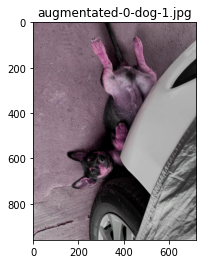

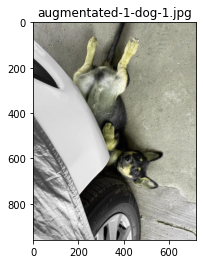

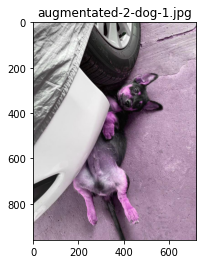

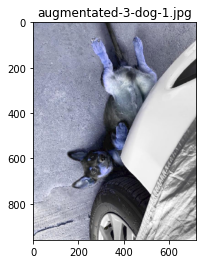

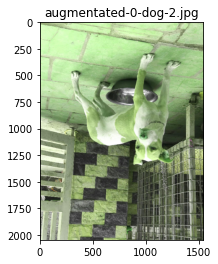

...

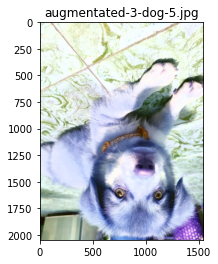

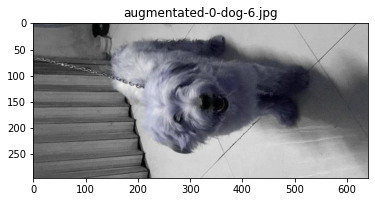

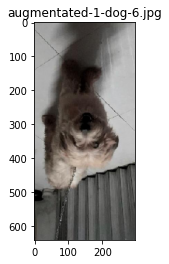

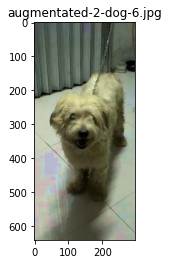

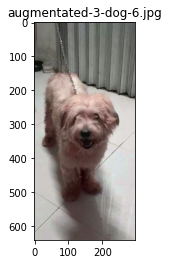

In [ ]:
display_img_from_directory(os.path.join(train_path, "dog", "augmentated"))

### cat augmentation

In [ ]:
augmentate_img_from_directory(
    src_path=os.path.join(train_path, "cat"),
    des_path=os.path.join(train_path, "cat", "augmentated"),
    repeat_times=4,
    compose_pipeline=compose_pipeline_1
)

save image 'augmentated-0-dog-1.jpg' to '/content/drive/MyDrive/Colab-Notebooks/data/animal/train/cat/augmentated
save image 'augmentated-1-dog-1.jpg' to '/content/drive/MyDrive/Colab-Notebooks/data/animal/train/cat/augmentated
save image 'augmentated-2-dog-1.jpg' to '/content/drive/MyDrive/Colab-Notebooks/data/animal/train/cat/augmentated
save image 'augmentated-3-dog-1.jpg' to '/content/drive/MyDrive/Colab-Notebooks/data/animal/train/cat/augmentated
save image 'augmentated-0-dog-2.jpg' to '/content/drive/MyDrive/Colab-Notebooks/data/animal/train/cat/augmentated
save image 'augmentated-1-dog-2.jpg' to '/content/drive/MyDrive/Colab-Notebooks/data/animal/train/cat/augmentated
save image 'augmentated-2-dog-2.jpg' to '/content/drive/MyDrive/Colab-Notebooks/data/animal/train/cat/augmentated
save image 'augmentated-3-dog-2.jpg' to '/content/drive/MyDrive/Colab-Notebooks/data/animal/train/cat/augmentated
save image 'augmentated-0-dog-3.jpg' to '/content/drive/MyDrive/Colab-Notebooks/data/ani

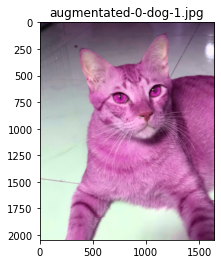

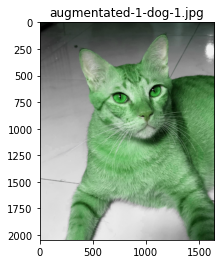

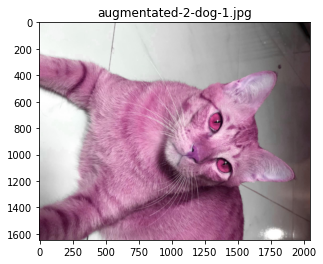

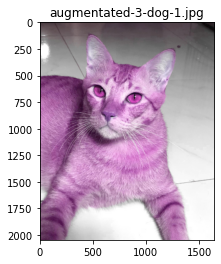

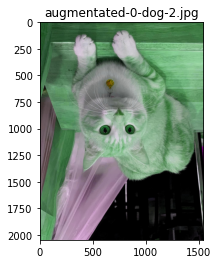

...

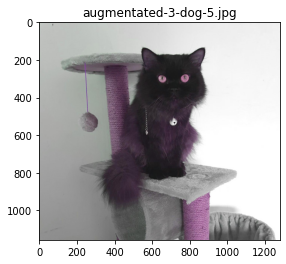

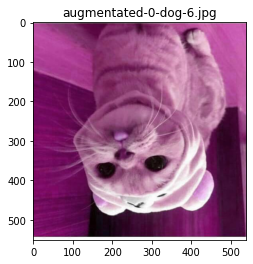

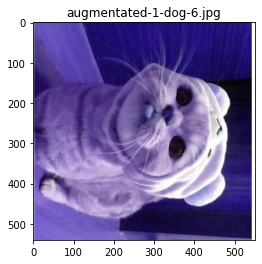

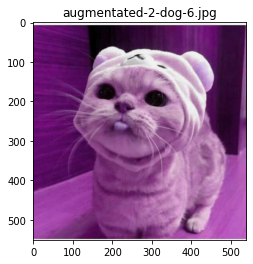

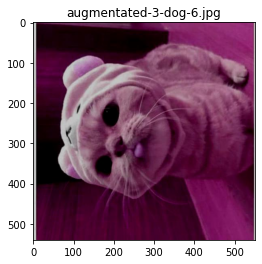

In [ ]:
display_img_from_directory(os.path.join(train_path, "cat", "augmentated"))

# [Problem 3] Preparation of object detection dataset

bbox plot source from Albumentations: https://colab.research.google.com/github/albumentations-team/albumentations_examples/blob/colab/example_bboxes.ipynb#scrollTo=NkAkwU-0kx5q

## defining bbox and image plot functions

In [5]:
BOX_COLOR = (255, 0, 0) # Red
TEXT_COLOR = (255, 255, 255) # White


def visualize_bbox(img, bbox, class_name, color=BOX_COLOR, thickness=2, format='pascal_voc'):
    """Visualizes a single bounding box on the image"""
    x_min = None
    y_min = None 
    x_max = None
    y_max = None
    if (format == 'coco'):
        x_min, y_min, w, h = bbox
        x_min, x_min, y_max, y_max = int(x_min), int(x_min + w), int(y_min), int(y_min + h)
    
    if (format == 'pascal_voc'):
        x_min, y_min, x_max, y_max = int(bbox[0]), int(bbox[1]), int(bbox[2]), int(bbox[3])
    
    cv2.rectangle(img, (x_min, y_min), (x_max, y_max), color=BOX_COLOR, thickness=thickness)
    
    ((text_width, text_height), _) = cv2.getTextSize(class_name, cv2.FONT_HERSHEY_SIMPLEX, 0.35, 1)    
    cv2.rectangle(img, (x_min, y_min - int(1.3 * text_height)), (x_min + text_width, y_min), BOX_COLOR, -1)
    cv2.putText(
        img,
        text=class_name,
        org=(x_min, y_min - int(0.3 * text_height)),
        fontFace=cv2.FONT_HERSHEY_SIMPLEX,
        fontScale=0.35, 
        color=TEXT_COLOR, 
        lineType=cv2.LINE_AA,
    )
    return img


def visualize(image, bboxes, labels, format):
    img = image.copy()
    for bbox, label in zip(bboxes, labels):
        img = visualize_bbox(img, bbox, label, format)
    plt.figure(figsize=(12, 12))
    plt.axis('off')
    plt.imshow(img)

## read bbox setting from XML file

After manually set the bbox using https://github.com/tzutalin/labelImg for the dataset, I read the bbox setting from the generated XML file as follow

In [6]:
import xml.etree.ElementTree as ET
import cv2
import glob

In [12]:
def extract_bbox_from_xml(file_path):
    xml_tree = ET.parse(file_path)
    xml_root = xml_tree.getroot()
    label = xml_root[6][0].text
    bbox = []
    for i in range(len(xml_root[6][4].getchildren())):
        bbox.append(int(xml_root[6][4][i].text))
    return bbox, label

def plot_bbox_from_directory(src_path, xml_path):
    img_file_list = [fi for fi in os.listdir(src_path) if (fi.endswith(".jpg"))]
    for i in range(len(img_file_list)):
        img_path = os.path.join(src_path, img_file_list[i])
        xml_file_path = os.path.join(xml_path, os.path.splitext(img_file_list[i])[0] + ".xml")
        bbox, label = extract_bbox_from_xml(xml_file_path)
        img = Image.open(img_path)
        img_np = np.array(img)
        visualize(img_np, [bbox], [label], 'pascal_voc')
        img.close()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: DeprecationWarning: This method will be removed in future versions.  Use 'list(elem)' or iteration over elem instead.
  


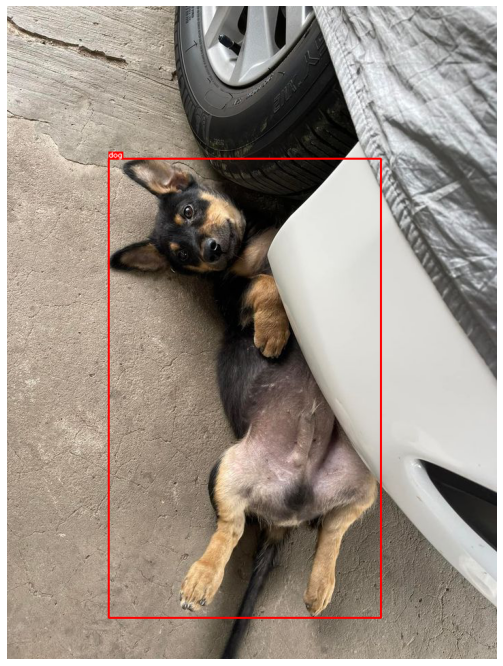

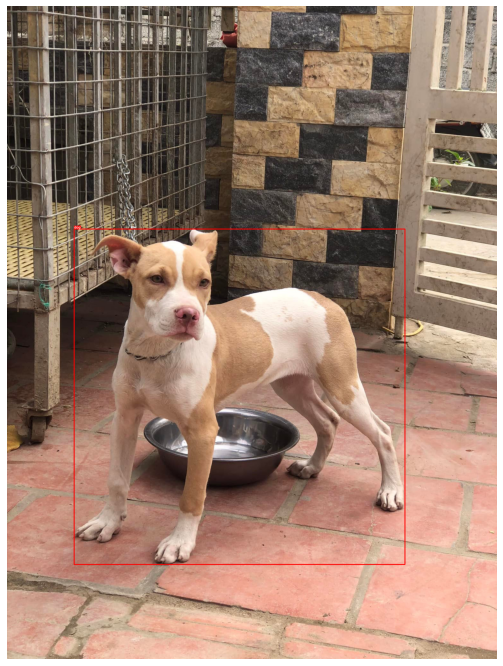

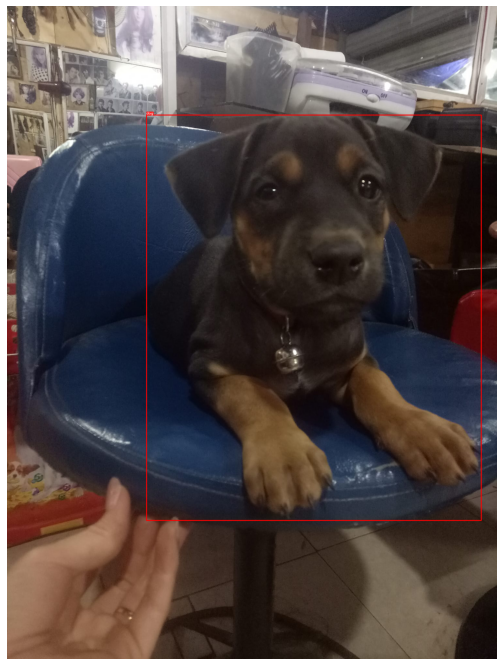

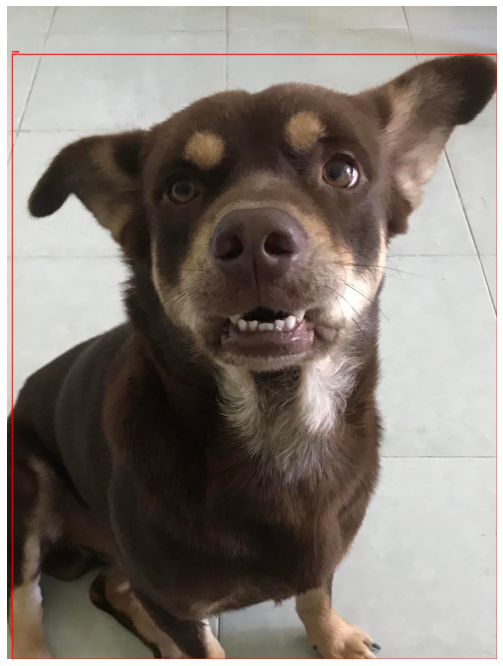

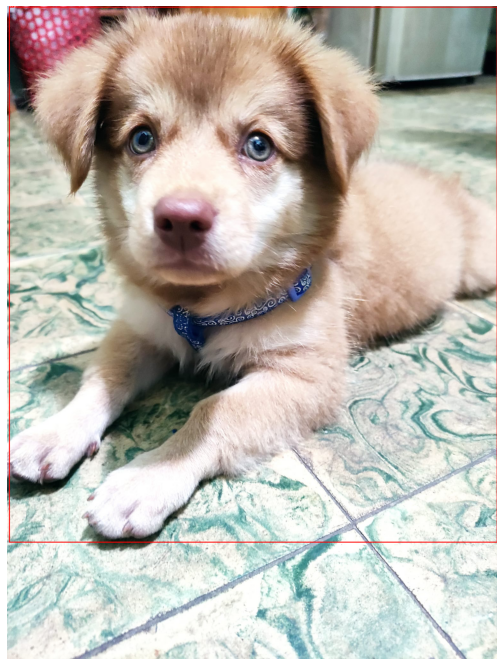

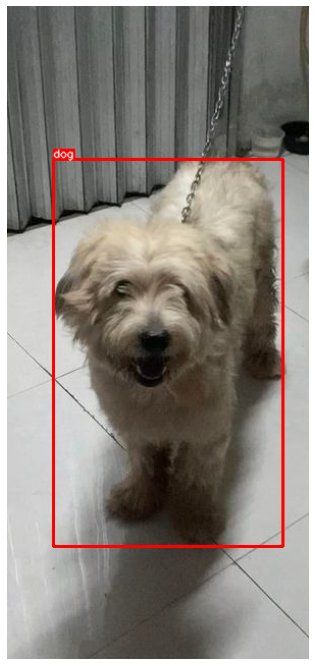

In [10]:
plot_bbox_from_directory(
    src_path='/content/drive/MyDrive/Colab-Notebooks/data/animal/train/dog/',
    xml_path='/content/drive/MyDrive/Colab-Notebooks/data/animal/train/dog/bbox'
    )

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: DeprecationWarning: This method will be removed in future versions.  Use 'list(elem)' or iteration over elem instead.
  


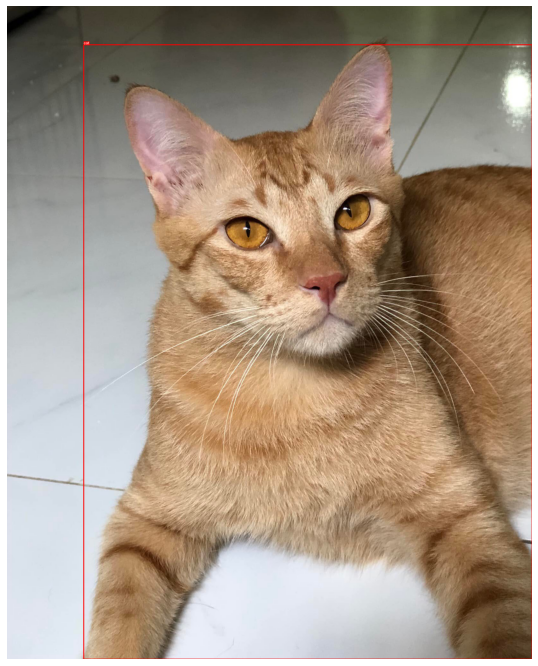

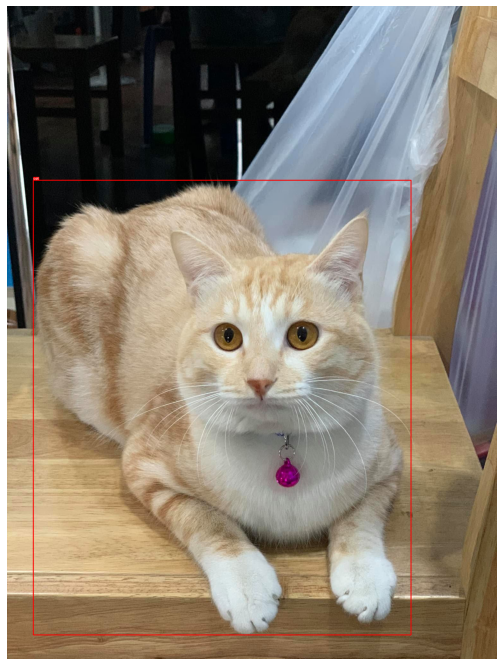

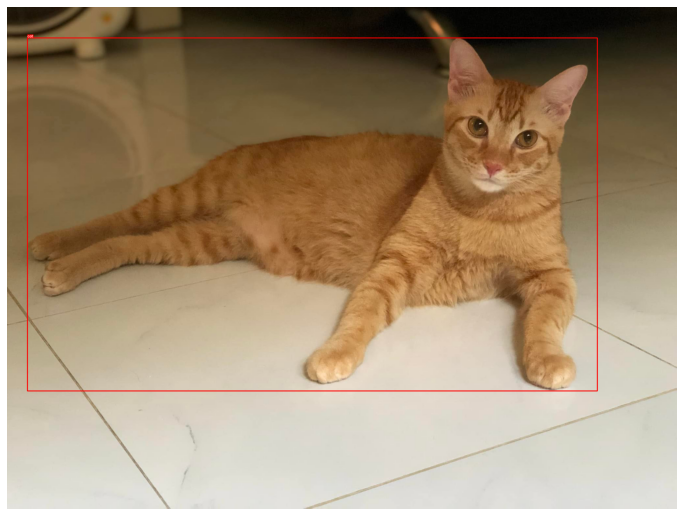

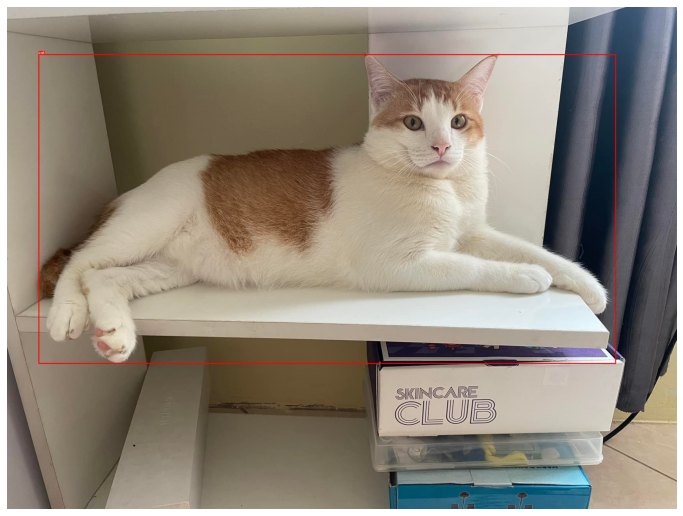

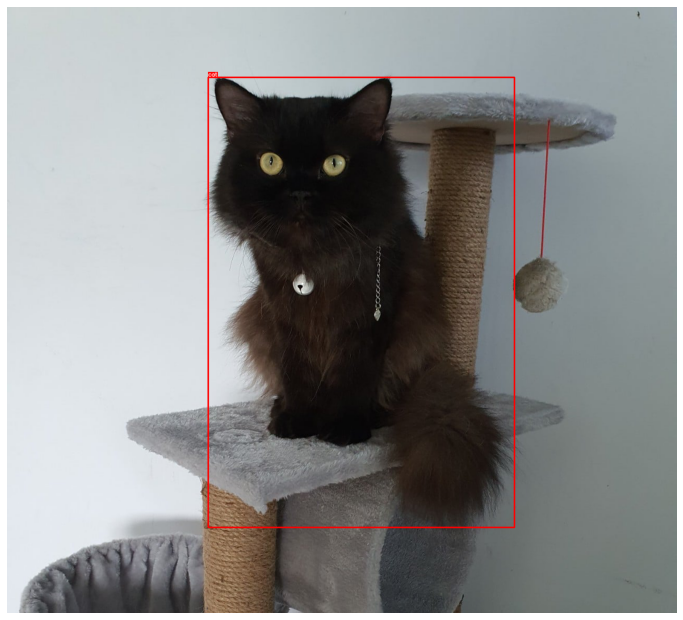

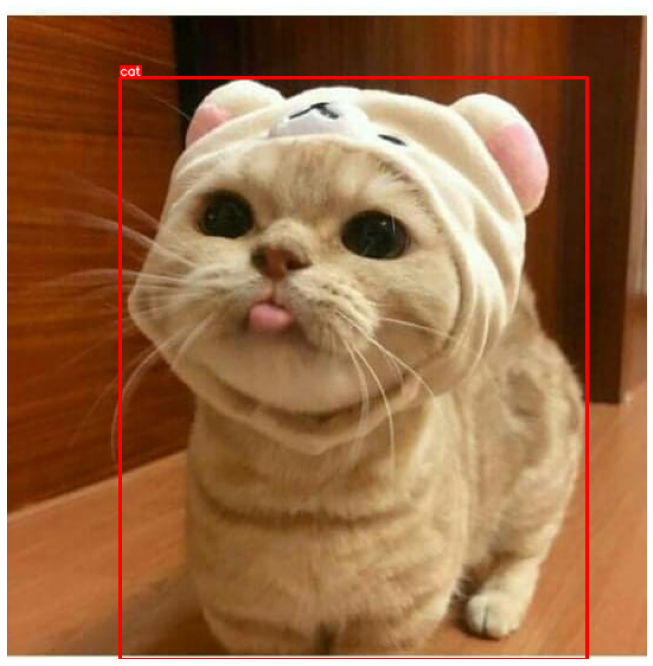

In [11]:
plot_bbox_from_directory(
    src_path='/content/drive/MyDrive/Colab-Notebooks/data/animal/train/cat/',
    xml_path='/content/drive/MyDrive/Colab-Notebooks/data/animal/train/cat/bbox'
    )

# [Problem 4] Data expansion for object detection dataset

In [25]:
def augmentate_img_with_bbox_from_directory(src_path, src_xml_path, repeat_times, compose_pipeline):
    """
    Augmentate images from the source folder for a repeat_times and visualise.
    Parameters:
    ----------
    src_path : path to get original images folder
    src_xml_path : path to get original bbox
    repeat_times : a repeated augmentation times for an image
    compose_pipeline : Compose pipeline from albumetation library
    """
    img_file_list = [fi for fi in os.listdir(src_path) if (fi.endswith(".jpg"))]

    for i in range(len(img_file_list)):
        img_file_path = os.path.join(src_path, img_file_list[i])
        xml_file_path = os.path.join(src_xml_path, os.path.splitext(img_file_list[i])[0] + ".xml")
        bbox, label = extract_bbox_from_xml(xml_file_path)
        img = Image.open(img_file_path)
        img_np = np.array(img)
        for j in range(repeat_times):
            transformed_data = compose_pipeline(image=img_np, bboxes=[bbox], labels=[label])
            visualize(transformed_data['image'], transformed_data['bboxes'], transformed_data['labels'], 'pascal_voc')
        img.close()

In [26]:
compose_pipeline_2 = A.Compose([
    A.ChannelShuffle(always_apply=False, p=0.5),
    A.HueSaturationValue(always_apply=False, p=1.0, hue_shift_limit=(-50, 50), sat_shift_limit=(-30, 30), val_shift_limit=(-20, 20)),
    A.Downscale(always_apply=False, p=0.2, scale_min=0.25, scale_max=0.75, interpolation=0),
    A.HorizontalFlip(always_apply=False, p=0.5),
    A.VerticalFlip(always_apply=False, p=0.5),
    A.Flip(always_apply=False, p=0.5),
    A.RandomRotate90(always_apply=False, p=0.5),
    A.RandomBrightnessContrast(always_apply=False, p=0.2),
    A.Resize(always_apply=False, p=1.0, height=256, width=256, interpolation=0)
], bbox_params=A.BboxParams(format='pascal_voc', min_visibility=0.5, label_fields=['labels']))

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: DeprecationWarning: This method will be removed in future versions.  Use 'list(elem)' or iteration over elem instead.
  
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:38: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


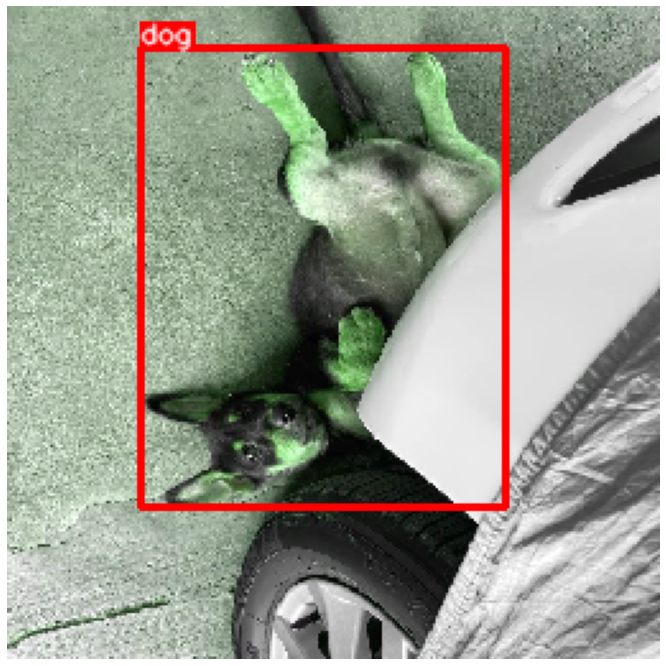

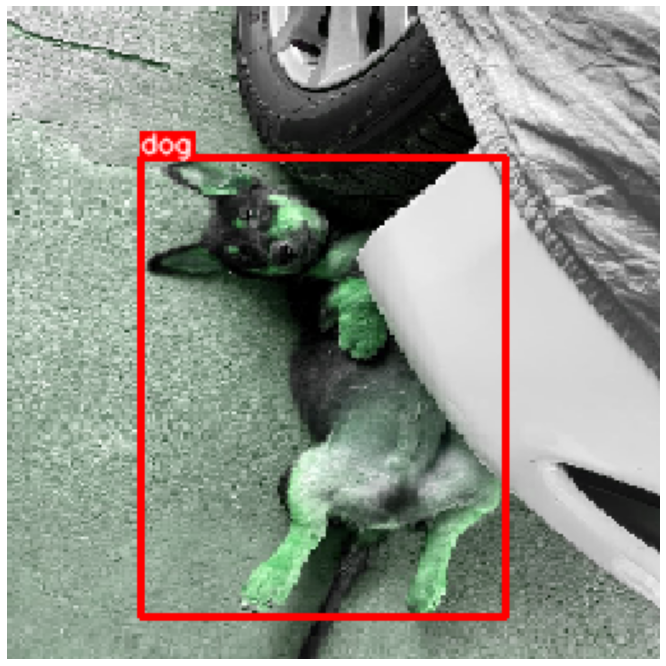

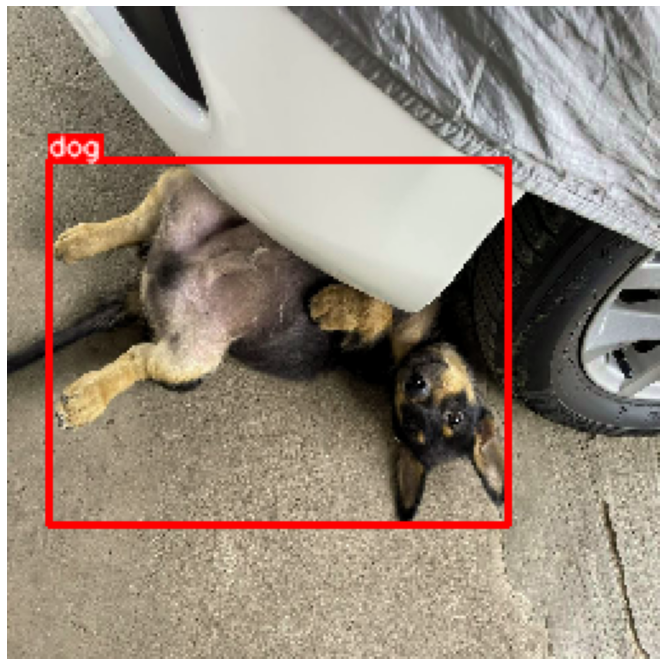

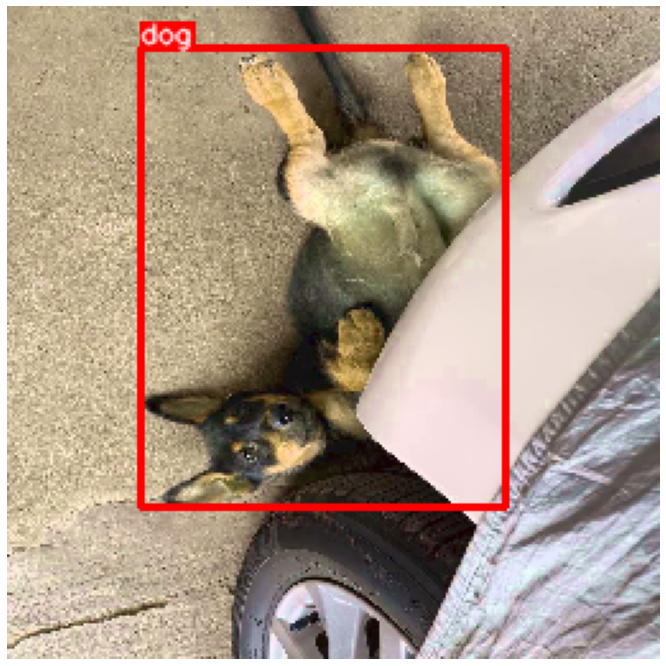

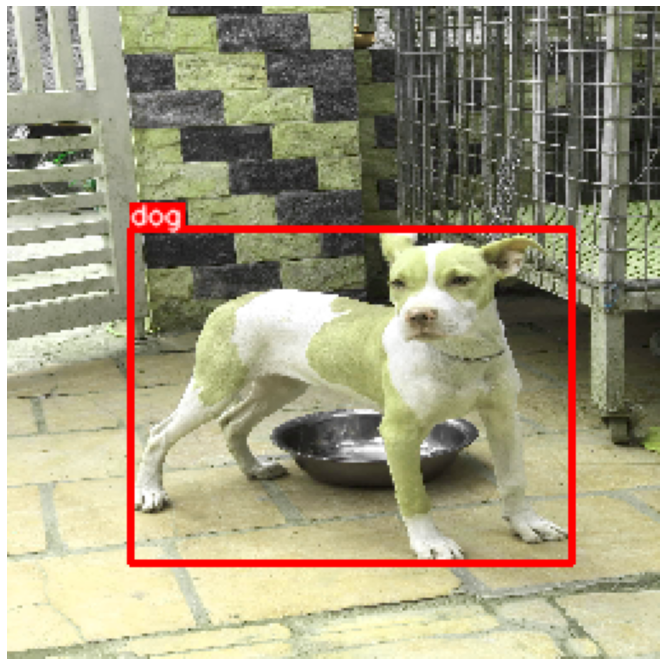

...

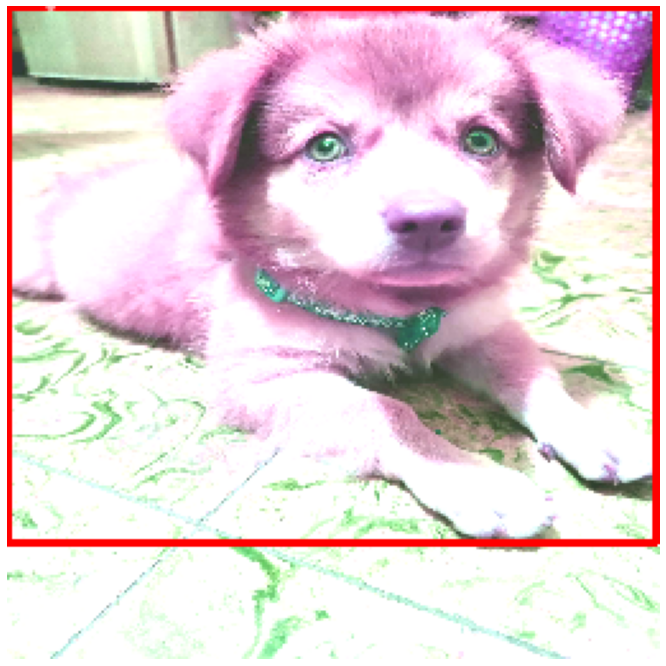

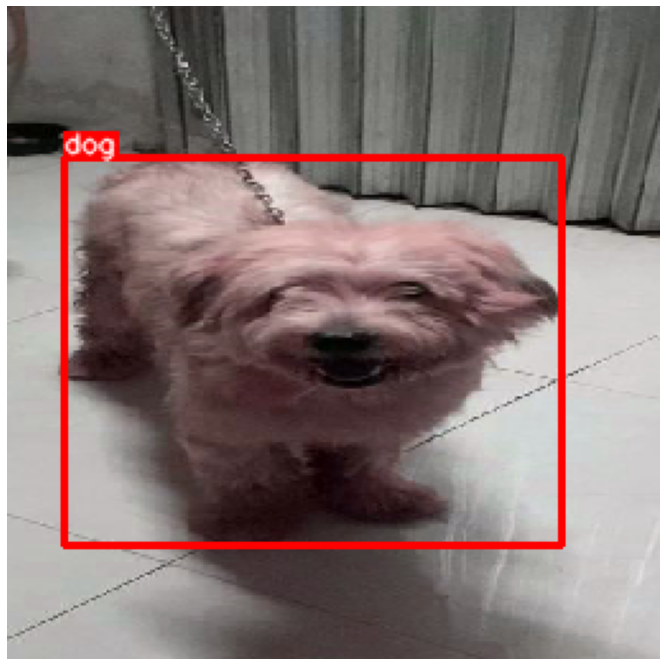

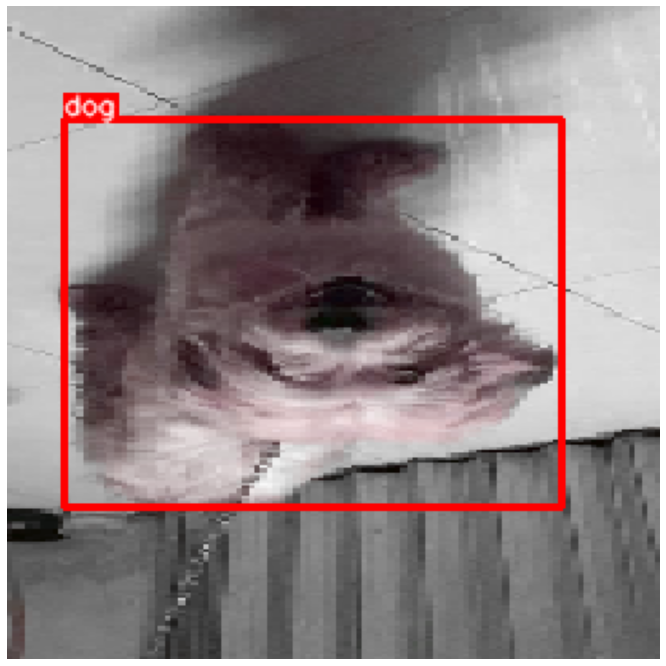

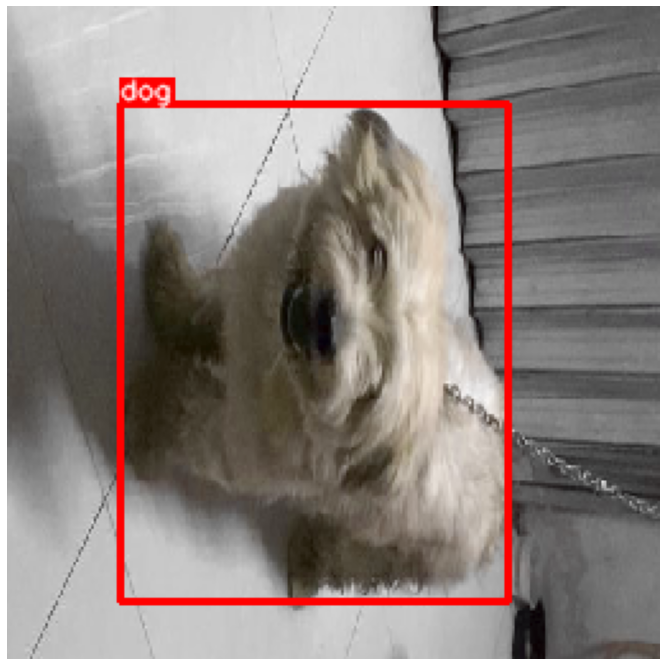

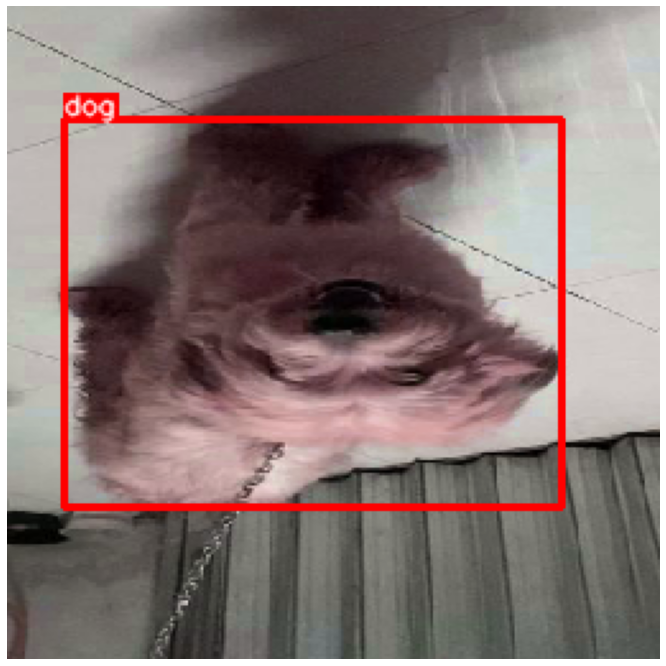

In [27]:
augmentate_img_with_bbox_from_directory(
    src_path=os.path.join(train_path, "dog"),
    src_xml_path=os.path.join(train_path, "dog", "bbox"),
    repeat_times=4,
    compose_pipeline=compose_pipeline_2
)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: DeprecationWarning: This method will be removed in future versions.  Use 'list(elem)' or iteration over elem instead.
  
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:38: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


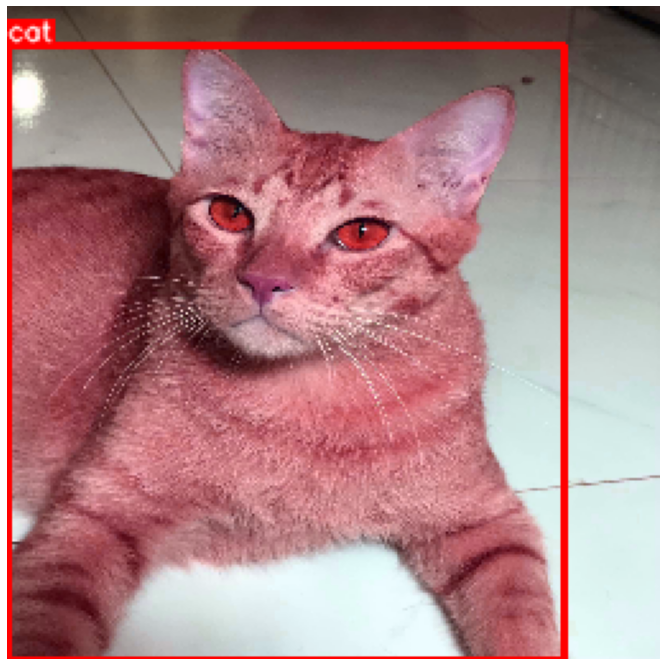

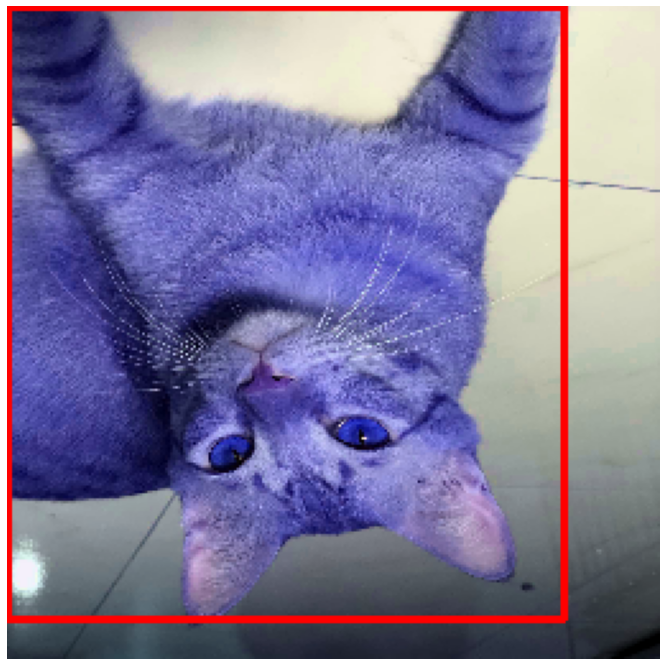

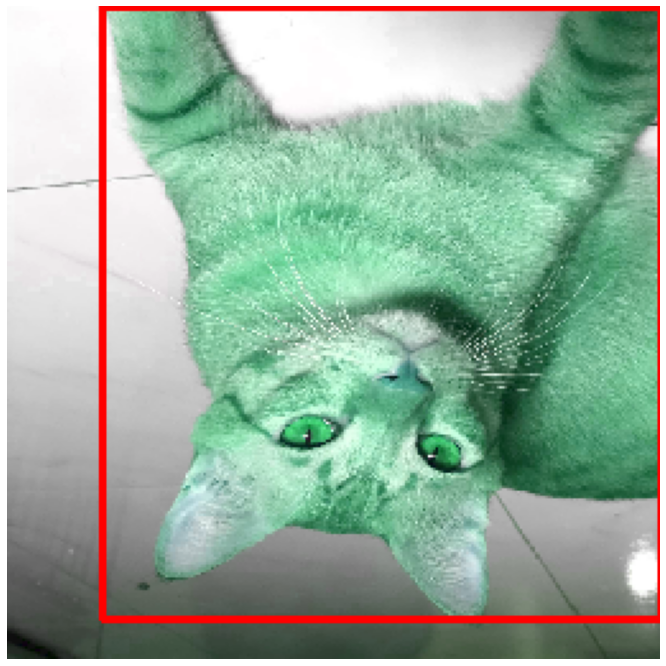

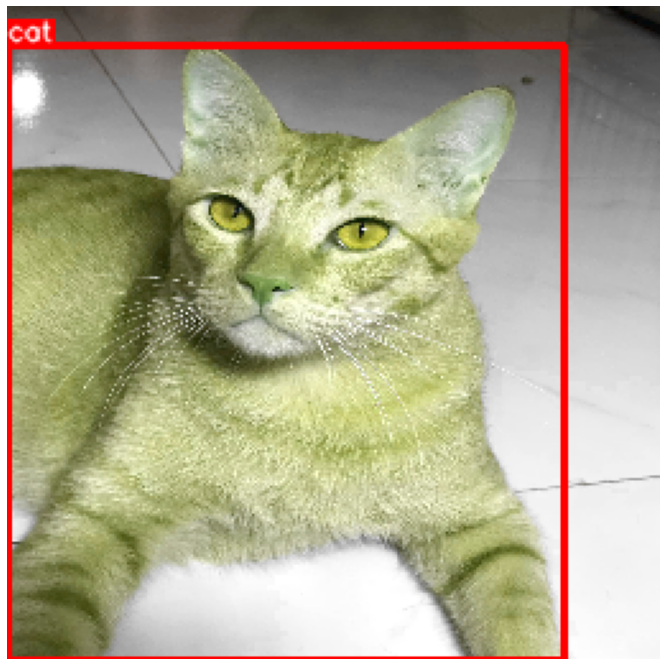

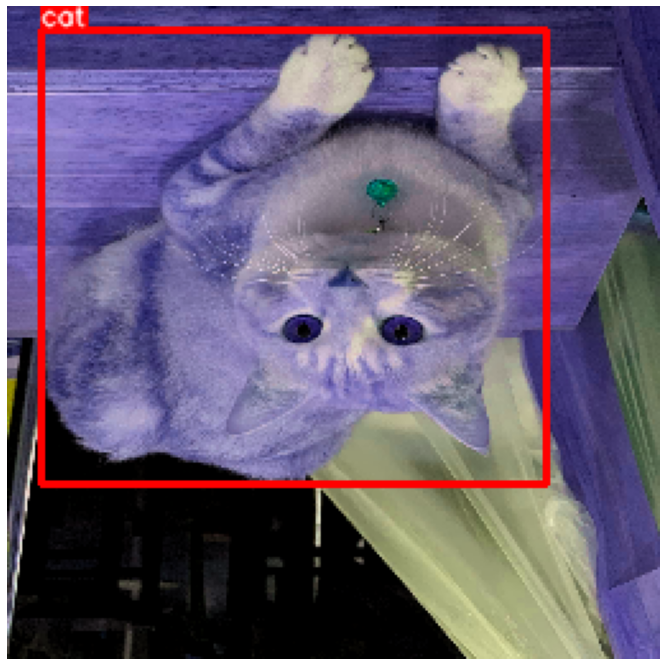

...

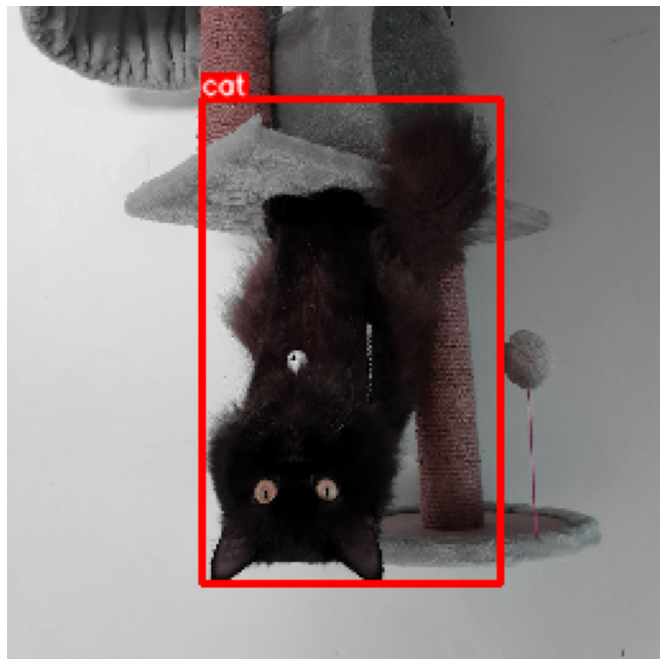

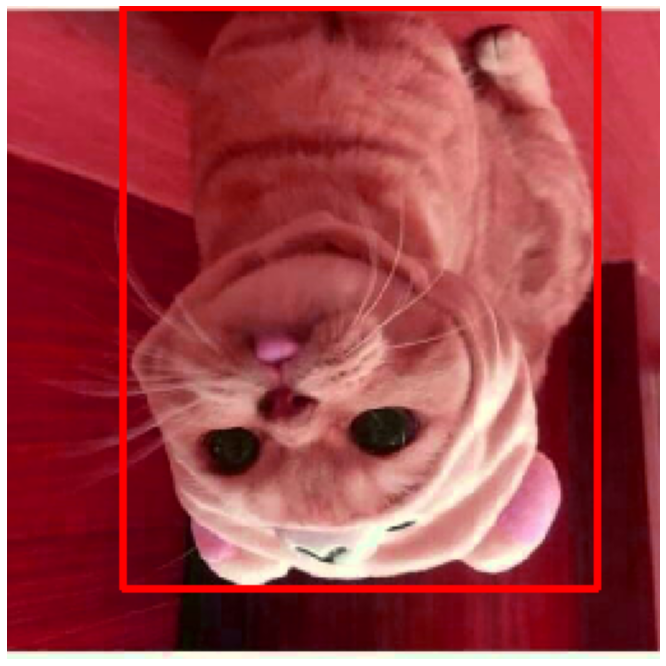

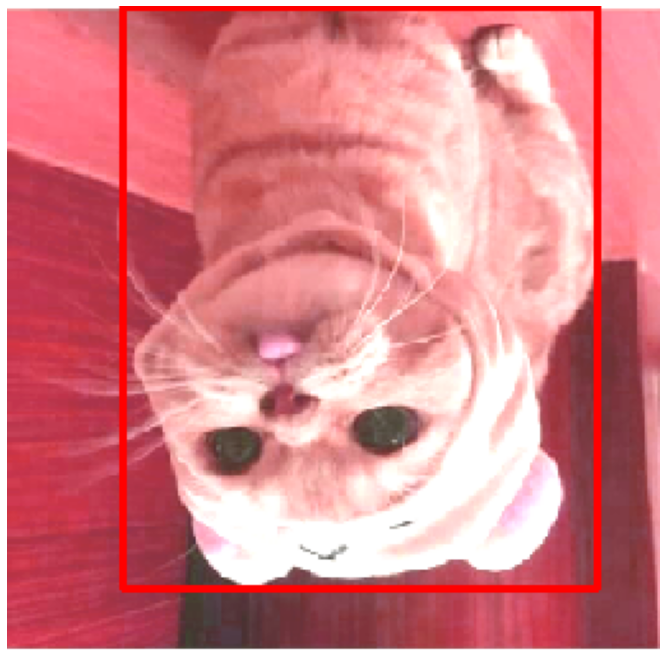

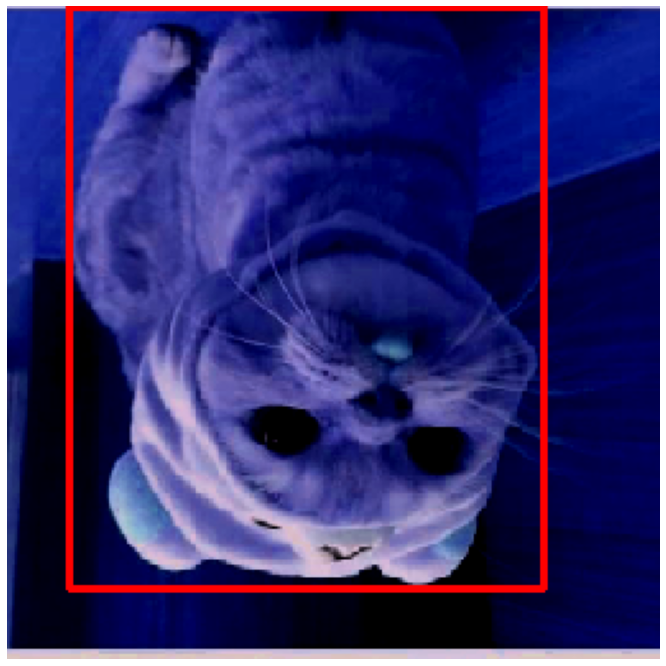

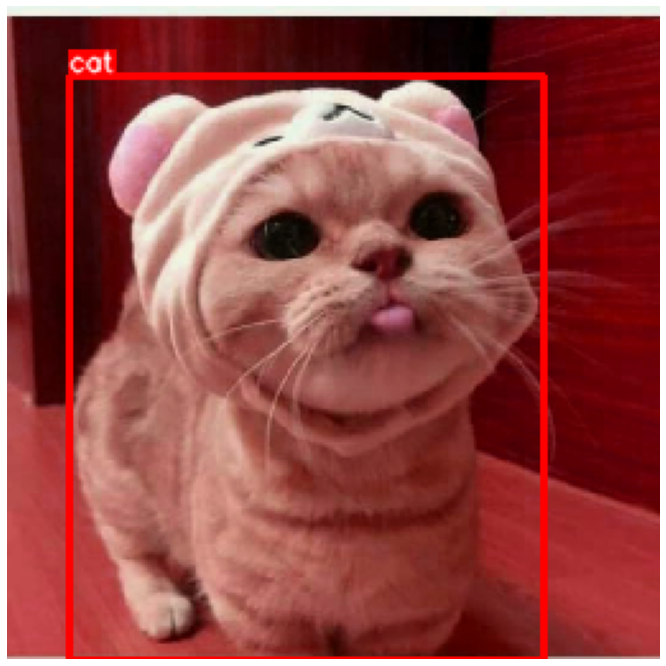

In [28]:
augmentate_img_with_bbox_from_directory(
    src_path=os.path.join(train_path, "cat"),
    src_xml_path=os.path.join(train_path, "cat", "bbox"),
    repeat_times=4,
    compose_pipeline=compose_pipeline_2
)